In [131]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import scale
from sklearn import datasets
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score, precision_recall_curve,f1_score, fbeta_score
from sklearn.model_selection import cross_val_score
from tqdm import tqdm, tqdm_notebook

plt.style.use('ggplot')
%matplotlib inline
np.set_printoptions(suppress=True) # Suppress scientific notation where possible

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
all_seasons_df = pd.read_csv('all_seasons_df.csv')

In [4]:
# This is my dataframe prior to dropping columns for KNN
all_seasons_df_PRE = all_seasons_df

In [1]:
all_seasons_df_PRE

NameError: name 'all_seasons_df_PRE' is not defined

In [5]:
# Replace Wins and Losses with 1 and 0, respectively for analysis
all_seasons_df['WL'].replace(to_replace =["W"], value ="1", inplace=True)
all_seasons_df['WL'].replace(to_replace =["L"], value ="0", inplace=True)

In [6]:
#all_seasons_df = all_seasons_df.reset_index()

In [7]:
all_seasons_df

,SEASON_YEAR,TEAM_ID,TEAM_ABBREVIATION,TEAM_NAME,GAME_ID,GAME_DATE,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS,GP_RANK,W_RANK,L_RANK,W_PCT_RANK,MIN_RANK,FGM_RANK,FGA_RANK,FG_PCT_RANK,FG3M_RANK,FG3A_RANK,FG3_PCT_RANK,FTM_RANK,FTA_RANK,FT_PCT_RANK,OREB_RANK,DREB_RANK,REB_RANK,AST_RANK,TOV_RANK,STL_RANK,BLK_RANK,BLKA_RANK,PF_RANK,PFD_RANK,PTS_RANK,PLUS_MINUS_RANK
0,2001-02,1610612765,DET,Detroit Pistons,20101181,2002-04-17T00:00:00,DET vs. MIL,1,24.0,25,46,0.543,8,12,0.667,6,7,0.857,9,18,27,16,8.0,5,1,2,9,0,64,20.0,1,1,1,1,1,71,327,283,8,119,129,1384,1662,529,259,403,172,168,1336,494,1673,707,903,80,50,50
1,2001-02,1610612749,MIL,Milwaukee Bucks,20101181,2002-04-17T00:00:00,MIL @ DET,0,24.0,19,40,0.475,2,6,0.333,4,8,0.500,5,11,16,8,7.0,4,2,1,11,0,44,-20.0,1,1190,1190,1190,1,987,1391,929,995,1160,1136,1903,1445,2170,1322,2044,2077,1963,986,856,1101,218,1555,80,1580,2320
2,2001-02,1610612758,SAC,Sacramento Kings,20101188,2002-04-17T00:00:00,SAC @ LAL,0,24.0,20,39,0.513,2,5,0.400,12,17,0.706,3,21,24,7,8.0,1,2,1,6,0,54,-2.0,1,1190,1190,1190,1,690,1636,515,995,1454,907,259,177,1514,1973,86,525,2144,1336,2146,1101,218,140,80,462,1318
3,2001-02,1610612752,NYK,New York Knicks,20101179,2002-04-17T00:00:00,NYK vs. NJN,0,24.0,18,45,0.400,3,14,0.214,4,4,1.000,9,17,26,9,8.0,2,1,0,11,1,43,4.0,1,1190,1190,1190,1,1280,450,1774,566,42,1781,1903,2153,1,259,602,271,1753,1336,1771,1673,1,1555,1,1723,790
4,2001-02,1610612737,ATL,Atlanta Hawks,20101176,2002-04-17T00:00:00,ATL @ BOS,0,24.0,13,43,0.302,0,3,0.000,13,16,0.813,10,17,27,8,8.0,8,2,4,4,0,39,-10.0,1,1190,1190,1190,1,2267,785,2341,2083,2001,2083,174,243,853,145,602,172,1963,1336,41,1101,1743,19,80,2076,1943
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46273,2020-21,1610612743,DEN,Denver Nuggets,22000019,2020-12-23T00:00:00,DEN vs. SAC,0,24.0,23,45,0.511,5,12,0.417,9,10,0.900,7,21,28,13,8.0,2,4,4,10,11,60,7.0,1,305,305,305,1,140,267,168,372,541,213,198,252,123,82,100,58,241,347,434,69,459,348,108,182,158
46274,2020-21,1610612751,BKN,Brooklyn Nets,22000001,2020-12-22T00:00:00,BKN vs. GSW,1,24.0,23,47,0.489,9,20,0.450,8,9,0.889,4,24,28,11,13.0,5,6,2,10,10,63,18.0,1,1,1,1,1,140,156,219,91,139,156,245,307,137,309,24,58,382,593,134,15,170,348,191,124,44
46275,2020-21,1610612747,LAL,Los Angeles Lakers,22000002,2020-12-22T00:00:00,LAL vs. LAC,0,24.0,17,40,0.425,5,17,0.294,15,20,0.750,3,21,24,10,11.0,3,0,0,12,17,54,-2.0,1,305,305,305,1,512,536,417,372,313,446,23,15,335,427,100,199,459,540,324,564,1,502,3,355,336
46276,2020-21,1610612744,GSW,Golden State Warriors,22000001,2020-12-22T00:00:00,GSW @ BKN,0,24.0,17,53,0.321,4,17,0.235,7,10,0.700,6,17,23,10,9.0,4,2,6,10,10,45,-18.0,1,305,305,305,1,512,14,592,466,313,522,300,252,416,136,311,249,459,420,223,267,584,348,191,541,562


In [8]:
# Columns to be dropped
all_seasons_df.drop(all_seasons_df.iloc[:, 30:], inplace = True, axis = 1)
all_seasons_df.drop(['SEASON_YEAR', 'TEAM_ABBREVIATION','TEAM_NAME', 'GAME_DATE',
                     'MATCHUP','TEAM_ID','GAME_ID','MIN'], axis=1, inplace=True)

In [9]:
all_seasons_WL_dropped_df = all_seasons_df.drop('WL', axis=1)

In [10]:
all_seasons_WL_dropped_df

,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS
0,25,46,0.543,8,12,0.667,6,7,0.857,9,18,27,16,8.0,5,1,2,9,0,64,20.0
1,19,40,0.475,2,6,0.333,4,8,0.500,5,11,16,8,7.0,4,2,1,11,0,44,-20.0
2,20,39,0.513,2,5,0.400,12,17,0.706,3,21,24,7,8.0,1,2,1,6,0,54,-2.0
3,18,45,0.400,3,14,0.214,4,4,1.000,9,17,26,9,8.0,2,1,0,11,1,43,4.0
4,13,43,0.302,0,3,0.000,13,16,0.813,10,17,27,8,8.0,8,2,4,4,0,39,-10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46273,23,45,0.511,5,12,0.417,9,10,0.900,7,21,28,13,8.0,2,4,4,10,11,60,7.0
46274,23,47,0.489,9,20,0.450,8,9,0.889,4,24,28,11,13.0,5,6,2,10,10,63,18.0
46275,17,40,0.425,5,17,0.294,15,20,0.750,3,21,24,10,11.0,3,0,0,12,17,54,-2.0
46276,17,53,0.321,4,17,0.235,7,10,0.700,6,17,23,10,9.0,4,2,6,10,10,45,-18.0


In [11]:
all_seasons_df['WL']=all_seasons_df['WL'].astype('int')

In [12]:
X_train, X_test, y_train, y_test = train_test_split(all_seasons_WL_dropped_df, all_seasons_df['WL'], \
                                                            test_size=0.2, random_state=41)
y_test

11504    0
14433    1
756      1
16464    0
34595    0
        ..
45194    0
21332    1
29585    1
13954    1
32594    1
Name: WL, Length: 9256, dtype: int64

all_seasons_df.loc[:,'WL'] = all_seasons_df.loc['WL'].astype('category')

In [29]:
knn = KNeighborsClassifier(n_neighbors=219)
knn.fit(X_train, y_train)
print("The score for kNN is")
print("Training: {:6.2f}%".format(100*knn.score(X_train, y_train)))
print("Test set: {:6.2f}%".format(100*knn.score(X_test, y_test)))

The score for kNN is
Training:  72.72%
Test set:  71.41%


**THE Test score IS the ERROR score!** (well, error = 100-test)
You don't worry about the training score.  It's just about the aboslute value of the test score.  So make a plot to heuristically justificy the hyparameter value choice (here, the hyparameter is k) of error vs hyperparameter value (so 100-teset score v k).

**Check k=300** for above.  Maybe do values and plot as justification.

## Scaling kNN

from https://www.datacamp.com/community/tutorials/preprocessing-in-data-science-part-1-centering-scaling-and-knn

In [13]:
# Check to make sure it's "WL" column in the correct type: int

all_seasons_df.dtypes

WL              int64
FGM             int64
FGA             int64
FG_PCT        float64
FG3M            int64
FG3A            int64
FG3_PCT       float64
FTM             int64
FTA             int64
FT_PCT        float64
OREB            int64
DREB            int64
REB             int64
AST             int64
TOV           float64
STL             int64
BLK             int64
BLKA            int64
PF              int64
PFD             int64
PTS             int64
PLUS_MINUS    float64
dtype: object

In [150]:
# Define a new variable for the dataframe used to kNN scaling.
# It needs to be the one with the 'WL' column dropped.
all_seasons_WL_dropped__scaled_df = scale(all_seasons_WL_dropped_df)

In [136]:
# Here you add the "_S" for the scaled data, which is only the X data.
# You also need to check and make sure the dataframe you're using is correct.
# Need the scaled one without the 'WL' column for the data and the target is
# the original dataframe 'all_seasons_df'.

X_train_S, X_test_S, y_train, y_test = train_test_split(all_seasons_WL_dropped__scaled_df, all_seasons_df['WL'], \
                                                            test_size=0.2, random_state=41)
y_test

11504    0
14433    1
756      1
16464    0
34595    0
        ..
45194    0
21332    1
29585    1
13954    1
32594    1
Name: WL, Length: 9256, dtype: int64

In [16]:
# Now the dataframe is an array i guess?

all_seasons_WL_dropped__scaled_df

array([[ 1.55600748,  0.81564562,  1.0444752 , ..., -1.65862299,
         1.58747616,  1.91015943],
       [-0.1333446 , -0.4919303 ,  0.16462836, ..., -1.65862299,
        -0.76274911, -1.91015943],
       [ 0.14821408, -0.70985962,  0.65630748, ..., -1.65862299,
         0.41236352, -0.19101594],
       ...,
       [-0.69646197, -0.4919303 , -0.48231784, ...,  2.13193847,
         0.41236352, -0.19101594],
       [-0.69646197,  2.34115086, -1.82796595, ...,  0.57111905,
        -0.64523785, -1.71914349],
       [ 0.42977276,  0.5977163 ,  0.06111697, ...,  1.01706745,
         0.64738605,  0.19101594]])

In [17]:
# Here you also need to make sure to used the scaled X objects.

knn = KNeighborsClassifier(n_neighbors=219)
knn.fit(X_train_S, y_train)
print("The score for scaled kNN is")
print("Training: {:6.2f}%".format(100*knn.score(X_train_S, y_train)))
print("Test set: {:6.2f}%".format(100*knn.score(X_test_S, y_test)))

The score for scaled kNN is
Training:  71.50%
Test set:  70.20%


## Cross Validation on scaled data

In [18]:
# 10-fold cross-validation with k=219 for kNN (the n_neighbors parameter)
knn = KNeighborsClassifier(n_neighbors=219)
scores = cross_val_score(knn, X_train_S, y_train, cv=10, scoring='accuracy')
print(scores)

[0.70645423 0.71077505 0.71366829 0.70853593 0.71961102 0.70340357
 0.70556456 0.70880605 0.71880065 0.71123717]


In [19]:
# use average accuracy as an estimate of out-of-sample accuracy
print(scores.mean())

0.7106856502087098


**STILL NEED TO GO THROUGH AND MAKE A PLOT OF error vs. k**.

## INSERT error v k plot here

Text(0, 0.5, 'Scaled and Cross-Validated Accuracy')

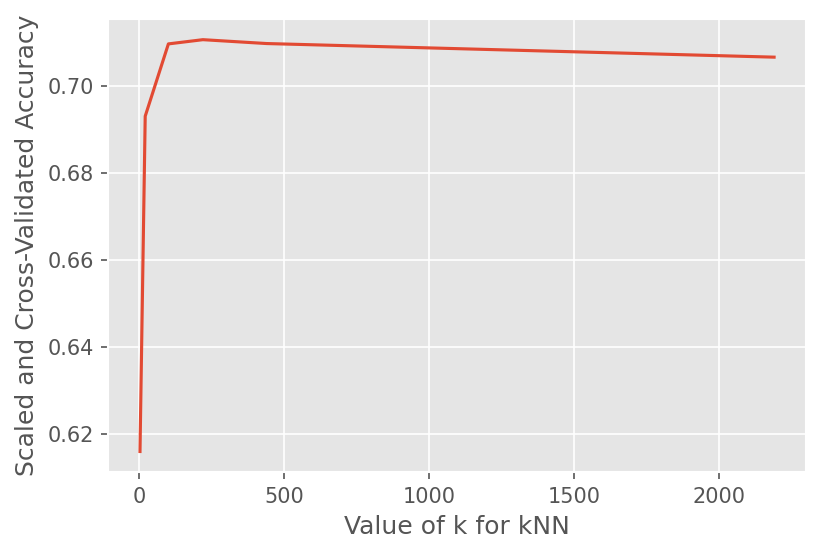

In [61]:
#Might be able to use this code, though it's unclear what data to use:

# now try with k-fold = 10 (cv parameter)
k_range = [2,20,100,219,439,2190]
k_scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_S, y_train, cv=10, scoring='accuracy')
    k_scores.append(scores.mean())

plt.figure(dpi=150)
plt.plot(k_range, k_scores)
plt.xlabel('Value of k for kNN')
plt.ylabel('Scaled and Cross-Validated Accuracy')

Text(0, 0.5, 'Scaled and Cross-Validated Accuracy')

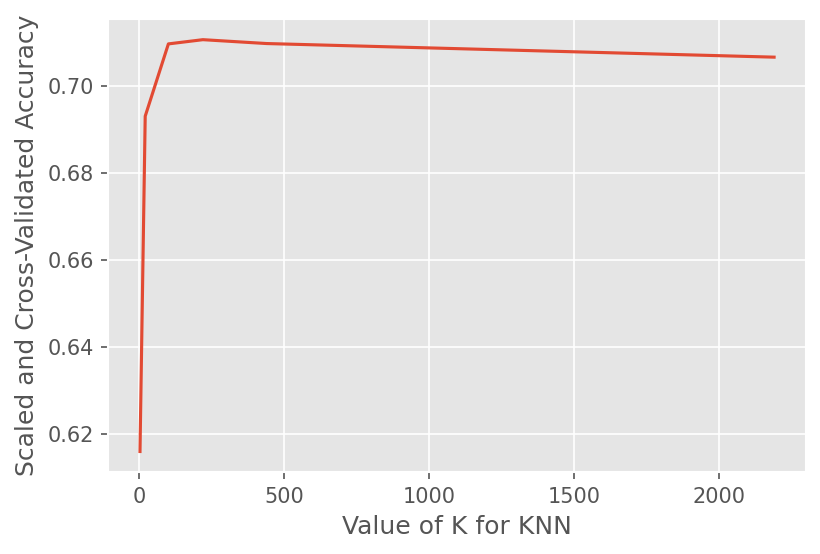

In [62]:
# plot the value of K for KNN (x-axis) versus the cross-validated accuracy (y-axis)
plt.figure(dpi=150)
plt.plot(k_range, k_scores)
plt.xlabel('Value of K for KNN')
plt.ylabel('Scaled and Cross-Validated Accuracy')

Text(0, 0.5, 'Scaled and Cross-Validated Accuracy')

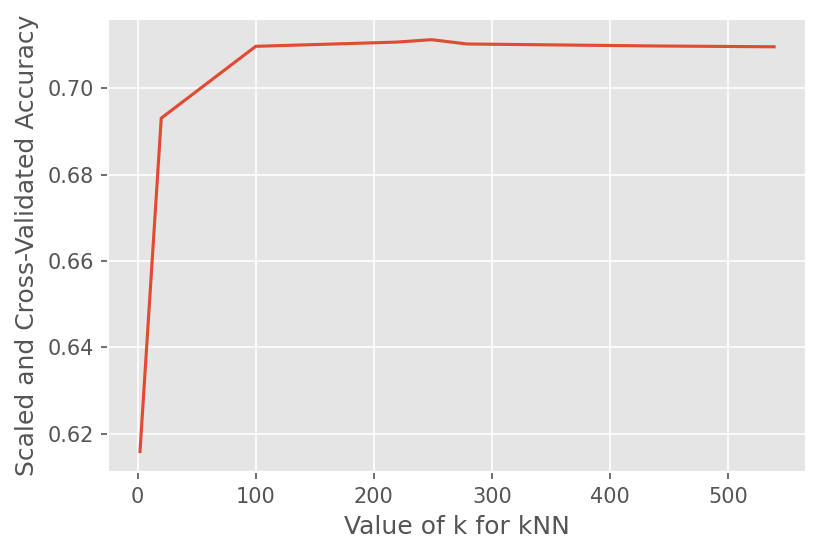

In [63]:
#Might be able to use this code, though it's unclear what data to use:

# now try with k-fold = 10 (cv parameter)
k_range = [2,20,100,219,249, 279,439,539]
k_scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_S, y_train, cv=10, scoring='accuracy')
    k_scores.append(scores.mean())

plt.figure(dpi=150)
plt.plot(k_range, k_scores)
plt.xlabel('Value of k for kNN')
plt.ylabel('Scaled and Cross-Validated Accuracy')

In [31]:
all_seasons_df['WL'].value_counts()

0    23139
1    23139
Name: WL, dtype: int64

**Find accuracy scores for k**
**Find error for k**

In [15]:
### Below is Chris's 'pseudo-code' idea of what the whack-the-best-a-kvalue

k_range = range(1, 101)
scores = []
for k in k_range:
    model = KNN(k=k)
    model.fit(X_train)
    pred = model.predict(X_val)
    accuracy = score(y_val, pred)
    score.append(accuracy)
k_scores = list(zip(scores, k_range))
max(k_scores)

## Logistic regression scaled

In [137]:
logit = LogisticRegression(C = 0.95)
logit.fit(X_train_S, y_train)
print("The score for the scaled logistic regression is")
print("Training: {:6.2f}%".format(100*logit.score(X_train_S, y_train)))
print("Test set: {:6.2f}%".format(100*logit.score(X_test_S, y_test)))

The score for the scaled logistic regression is
Training:  72.55%
Test set:  71.63%


In [47]:
logit.predict_proba(X_test_S[:5])

array([[0.47696099, 0.52303901],
       [0.39197341, 0.60802659],
       [0.59035096, 0.40964904],
       [0.73327316, 0.26672684],
       [0.43549245, 0.56450755]])

In [27]:
#Check for scaling.  I added it here on feb 4 2021 2:34PM

from sklearn.metrics import confusion_matrix

print("kNN confusion matrix: \n\n", confusion_matrix(y_test, knn.predict(X_test_S)))

NotFittedError: This KNeighborsClassifier instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [134]:
# Print confusion matrix for kNN
#Check for scaling.  I added it here on feb 4 2021 2:34PM

knn_confusion = confusion_matrix(y_test, knn.predict(X_test_S))
plt.figure(dpi=150)
sns.heatmap(knn_confusion, cmap=plt.cm.Blues, annot=True, square=True)

plt.xlabel('Predicted Wins-Losses')
plt.ylabel('Actual Wins-Losses')
plt.title('NBA Halftime Win-Loss Predictor Model');

NotFittedError: This KNeighborsClassifier instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

## Logistic Model

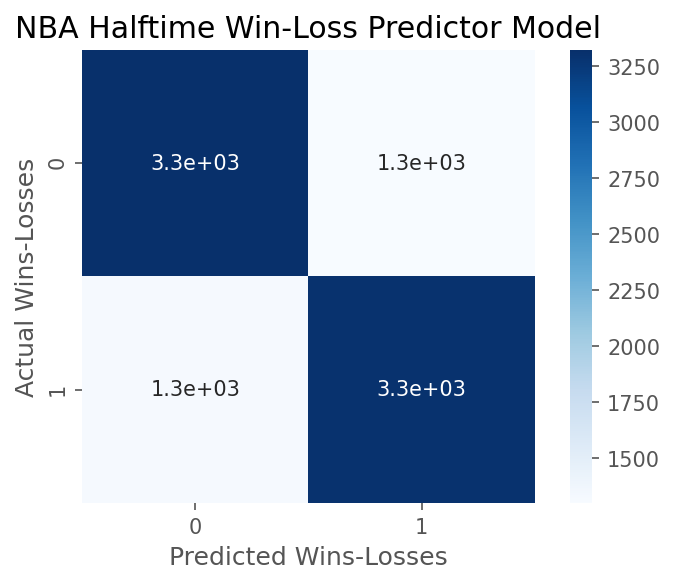

In [138]:
# Print confusion matrix for logistic regression
#Check for scaling.  I added it here on feb 4 2021 2:34PM

logit_confusion = confusion_matrix(y_test, logit.predict(X_test_S))
plt.figure(dpi=150)
sns.heatmap(logit_confusion, cmap=plt.cm.Blues, annot=True, square=True)

plt.xlabel('Predicted Wins-Losses')
plt.ylabel('Actual Wins-Losses')
plt.title('NBA Halftime Win-Loss Predictor Model');

plt.savefig("NBA Halftime Win-Loss Predictor Model")

### Logistic Model - Cross validation

In [19]:
# The train data here is for the correct df where 'WL'  is dropped.

lr = LogisticRegression()
lr.fit(X_train,y_train)

LogisticRegression()

In [20]:
lr.predict(X_test)

array([1, 1, 0, ..., 1, 0, 1])

# Use this Logistic Regression accuracy score

In [22]:
lr.score(X_test,y_test)

0.7161840968020743

<AxesSubplot:>

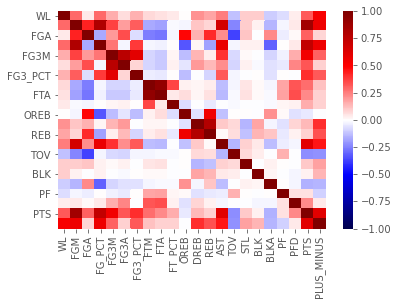

In [21]:
#Not scaled...just entering this as a note that I don't need to use
# scaled data.

sns.heatmap(all_seasons_df.corr(), cmap="seismic", annot=False, vmin=-1, vmax=1, fmt=".2f")

## The pairplot will take >6minutes to plot

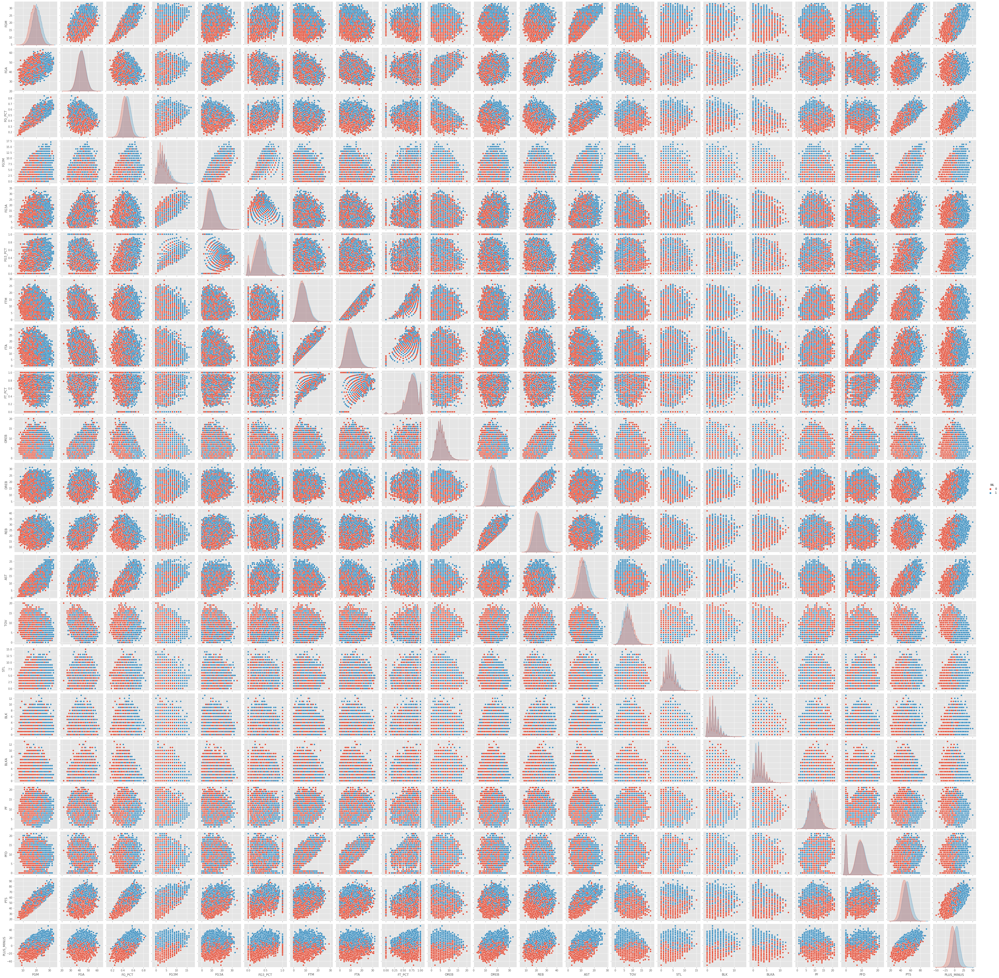

In [37]:
doot = sns.pairplot(all_seasons_df, hue='WL')

In [38]:
doot.fig.savefig("all_seasons_df_pairplot.png", format="png")

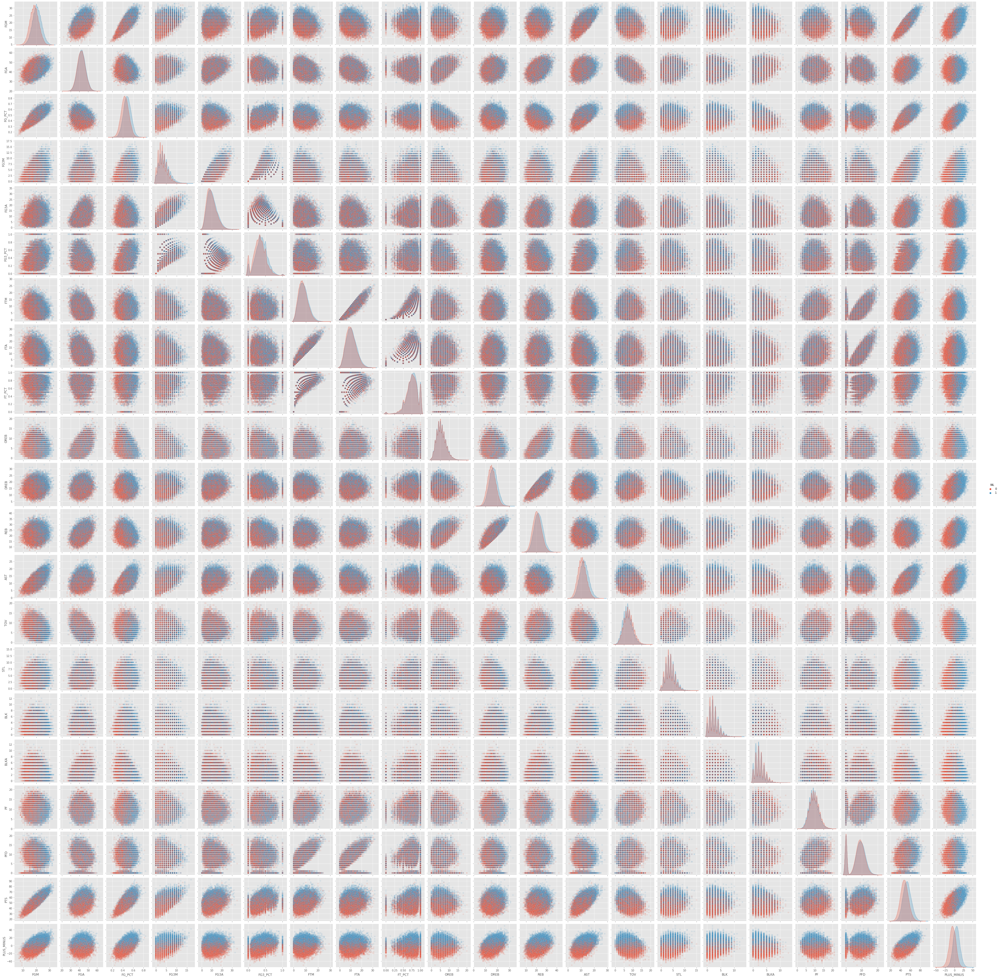

In [47]:
dootdoot = sns.pairplot(all_seasons_df, hue='WL', plot_kws={'alpha':0.1})

In [48]:
dootdoot.fig.savefig("all_seasons_df_pairplot_alpha.png", format="png", dpi=300)

In [213]:
doot6plot_df = all_seasons_df[['WL','PTS','PLUS_MINUS']]

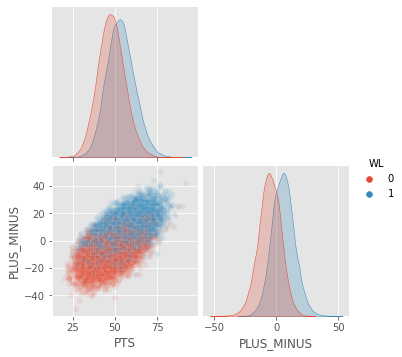

In [216]:
doot6 = sns.pairplot(data=doot6plot_df, hue='WL', plot_kws={'alpha':0.1}, corner=True, diag_kws=dict(fill=True))

In [266]:
doot6.fig.savefig("doot6.pdf", format="pdf", dpi=300)

## Isolating features

In [203]:
dave = sns.distplot(data=all_seasons_df, x="PLUS_MINUS", alpha=0.5, hue='WL', element="step")

TypeError: distplot() got an unexpected keyword argument 'data'

In [199]:
dave.figure.savefig("PLUS_MINUS_histplot.png", format="png", dpi=300)

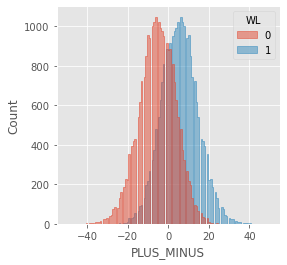

In [260]:
mike = sns.histplot(data=all_seasons_df, x="PLUS_MINUS", alpha=0.5, hue='WL', element="step")

In [263]:
mike.figure.savefig("PLUS_MINUS", format="pdf")

List of features that may help predict winner:
* "PTS"
* "PLUS_MINUS"
* "PG_PCT"
* "STL"
* "BLK"
* "PF"

# Isolating 6 features

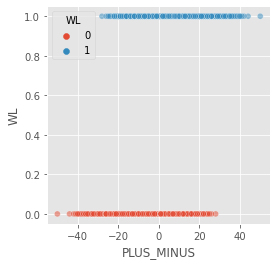

In [268]:
Sandy = sns.scatterplot(data=all_seasons_df, x="PLUS_MINUS", y='WL',alpha=0.5, hue='WL')

In [64]:
dave.figure.savefig("DREB_FGPCT.png", format="png", dpi=300)

In [123]:
all_seasons_df

,WL,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS
0,1,25,46,0.543,8,12,0.667,6,7,0.857,9,18,27,16,8.0,5,1,2,9,0,64,20.0
1,0,19,40,0.475,2,6,0.333,4,8,0.500,5,11,16,8,7.0,4,2,1,11,0,44,-20.0
2,0,20,39,0.513,2,5,0.400,12,17,0.706,3,21,24,7,8.0,1,2,1,6,0,54,-2.0
3,0,18,45,0.400,3,14,0.214,4,4,1.000,9,17,26,9,8.0,2,1,0,11,1,43,4.0
4,0,13,43,0.302,0,3,0.000,13,16,0.813,10,17,27,8,8.0,8,2,4,4,0,39,-10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46273,0,23,45,0.511,5,12,0.417,9,10,0.900,7,21,28,13,8.0,2,4,4,10,11,60,7.0
46274,1,23,47,0.489,9,20,0.450,8,9,0.889,4,24,28,11,13.0,5,6,2,10,10,63,18.0
46275,0,17,40,0.425,5,17,0.294,15,20,0.750,3,21,24,10,11.0,3,0,0,12,17,54,-2.0
46276,0,17,53,0.321,4,17,0.235,7,10,0.700,6,17,23,10,9.0,4,2,6,10,10,45,-18.0


In [25]:
all_seasons_df.dtypes

WL              int64
FGM             int64
FGA             int64
FG_PCT        float64
FG3M            int64
FG3A            int64
FG3_PCT       float64
FTM             int64
FTA             int64
FT_PCT        float64
OREB            int64
DREB            int64
REB             int64
AST             int64
TOV           float64
STL             int64
BLK             int64
BLKA            int64
PF              int64
PFD             int64
PTS             int64
PLUS_MINUS    float64
dtype: object

In [64]:
all_seasons_df

,WL,FGM,FGA,FG_PCT,FG3M,FG3A,FG3_PCT,FTM,FTA,FT_PCT,OREB,DREB,REB,AST,TOV,STL,BLK,BLKA,PF,PFD,PTS,PLUS_MINUS
0,1,25,46,0.543,8,12,0.667,6,7,0.857,9,18,27,16,8.0,5,1,2,9,0,64,20.0
1,0,19,40,0.475,2,6,0.333,4,8,0.500,5,11,16,8,7.0,4,2,1,11,0,44,-20.0
2,0,20,39,0.513,2,5,0.400,12,17,0.706,3,21,24,7,8.0,1,2,1,6,0,54,-2.0
3,0,18,45,0.400,3,14,0.214,4,4,1.000,9,17,26,9,8.0,2,1,0,11,1,43,4.0
4,0,13,43,0.302,0,3,0.000,13,16,0.813,10,17,27,8,8.0,8,2,4,4,0,39,-10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46273,0,23,45,0.511,5,12,0.417,9,10,0.900,7,21,28,13,8.0,2,4,4,10,11,60,7.0
46274,1,23,47,0.489,9,20,0.450,8,9,0.889,4,24,28,11,13.0,5,6,2,10,10,63,18.0
46275,0,17,40,0.425,5,17,0.294,15,20,0.750,3,21,24,10,11.0,3,0,0,12,17,54,-2.0
46276,0,17,53,0.321,4,17,0.235,7,10,0.700,6,17,23,10,9.0,4,2,6,10,10,45,-18.0


In [65]:
all_seasons_df.to_csv('all_seasons_df', index=False)

# Logistic feature engineering

In [155]:
all_seasons_df_SCALED = scale(all_seasons_df[['PTS','PLUS_MINUS','FG_PCT','STL','BLK','PF']])

In [154]:
"PTS"
"PLUS_MINUS"
"FG_PCT"
"STL"
"BLK"
"PF"

'PF'

In [156]:
# Splits for feature engineering

X_train_sub6, X_test_sub6, y_train_sub6, y_test_sub6 = train_test_split(all_seasons_df_SCALED, all_seasons_df['WL'], \
                                                            test_size=0.2, random_state=41)
y_test_sub1

11504    0
14433    1
756      1
16464    0
34595    0
        ..
45194    0
21332    1
29585    1
13954    1
32594    1
Name: WL, Length: 9256, dtype: int64

In [158]:
logit = LogisticRegression(C = 0.95)
logit.fit(X_train_sub6, y_train_sub6)
print("The score for logistic regression is")
print("Training: {:6.2f}%".format(100*logit.score(X_train_sub6, y_train_sub6)))
print("Test set: {:6.2f}%".format(100*logit.score(X_test_sub6, y_test_sub6)))

The score for logistic regression is
Training:  72.47%
Test set:  71.54%


In [159]:
p = PolynomialFeatures(degree=2,interaction_only=True)
p.fit(X_train_sub6)
x_train_poly = p.transform(X_train_sub6)

logit.fit(x_train_poly,y_train)
logit.score(x_train_poly,y_train)
print('Training R^2 score: ', logit.score(x_train_poly,y_train))
print('Training coef: ', logit.coef_)

Training R^2 score:  0.7248933066825131
Training coef:  [[ 0.00230488  0.04734534  1.47979948 -0.05088683  0.00764675  0.06447871
  -0.06939001 -0.01781332  0.00232435 -0.02203564  0.02719097 -0.02034623
  -0.01189863  0.02355435  0.0159717  -0.00586919  0.02558888 -0.03034865
   0.02441081 -0.02348679  0.0100382  -0.01318938]]


In [160]:
x_val_poly_test = p.transform(X_test_sub6)
logit.score(x_val_poly_test, y_test)

0.7159680207433017

## Now only 2 score features

In [176]:
all_seasons_df_SCALED2 = scale(all_seasons_df[['PTS','PLUS_MINUS']])

In [177]:
# Splits for feature engineering

X_train_sub2, X_test_sub2, y_train_sub2, y_test_sub2 = train_test_split(all_seasons_df_SCALED2, all_seasons_df['WL'], \
                                                            test_size=0.2, random_state=41)
y_test_sub2

11504    0
14433    1
756      1
16464    0
34595    0
        ..
45194    0
21332    1
29585    1
13954    1
32594    1
Name: WL, Length: 9256, dtype: int64

In [178]:
logit = LogisticRegression(C = 0.95)
logit.fit(X_train_sub2, y_train_sub2)
print("The score for logistic regression is")
print("Training: {:6.2f}%".format(100*logit.score(X_train_sub2, y_train_sub2)))
print("Test set: {:6.2f}%".format(100*logit.score(X_test_sub2, y_test_sub2)))

The score for logistic regression is
Training:  72.41%
Test set:  71.38%


In [186]:
p = PolynomialFeatures(degree=2,interaction_only=True)
p.fit(X_train_sub2)
x_train_poly2 = p.transform(X_train_sub2)

logit.fit(x_train_poly2,y_train)
logit.score(x_train_poly2,y_train)
print('Training R^2 score: ', logit.score(x_train_poly2,y_train))
print('Training coef: ', logit.coef_)

Training R^2 score:  0.7238128680244179
Training coef:  [[ 0.00192043 -0.00401746  1.49500232 -0.02037686]]


In [191]:
x_poly_test2 = p.transform(X_test_sub2)
logit.score(x_poly_test2, y_test_sub2)

0.7151037165082109

### ROC/AUC with 2 features

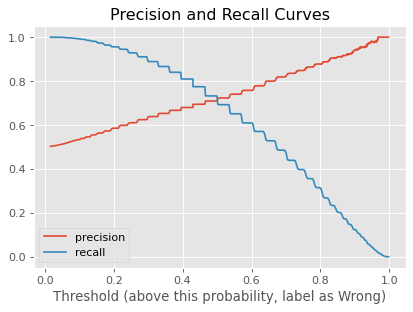

In [192]:
# We can also use the probabilities to make a curve showing us how recall 
# and thresholds trade off 

precision_curve, recall_curve, threshold_curve = precision_recall_curve(y_test, logit.predict_proba(x_poly_test2)[:,1] )

plt.figure(dpi=80)
plt.plot(threshold_curve, precision_curve[1:],label='precision')
plt.plot(threshold_curve, recall_curve[1:], label='recall')
plt.legend(loc='lower left')
plt.xlabel('Threshold (above this probability, label as Wrong)');
plt.title('Precision and Recall Curves');

In [193]:
fpr, tpr, thresholds = roc_curve(y_test, logit.predict_proba(x_poly_test2)[:,1])

In [238]:
taste = fpr, tpr, thresholds

ROC AUC score =  0.7988923894683062


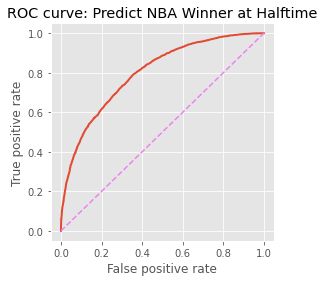

In [257]:

plt.plot(fpr, tpr,lw=2)
plt.plot([0,1],[0,1],c='violet',ls='--')
plt.xlim([-0.05,1.05])
plt.ylim([-0.05,1.05])
plt.rcParams["figure.figsize"] = (4,4)
plt.savefig('test2png', dpi=300, format='pdf')

plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve: Predict NBA Winner at Halftime');
print("ROC AUC score = ", roc_auc_score(y_test, logit.predict_proba(x_poly_test2)[:,1]))

In [240]:
space


Above is only a tiny tiny bit lower than with moer features


In [224]:
type(space)

list

## Now only 1 feature

In [167]:
all_seasons_df_SCALED1 = scale(all_seasons_df[['PLUS_MINUS']])

In [168]:
# Splits for feature engineering

X_train_sub1, X_test_sub1, y_train_sub1, y_test_sub1 = train_test_split(all_seasons_df_SCALED1, all_seasons_df['WL'], \
                                                            test_size=0.2, random_state=41)
y_test_sub2

11504    0
14433    1
756      1
16464    0
34595    0
        ..
45194    0
21332    1
29585    1
13954    1
32594    1
Name: WL, Length: 9256, dtype: int64

In [170]:
logit = LogisticRegression(C = 0.95)
logit.fit(X_train_sub1, y_train_sub1)
print("The score for logistic regression is")
print("Training: {:6.2f}%".format(100*logit.score(X_train_sub1, y_train_sub1)))
print("Test set: {:6.2f}%".format(100*logit.score(X_test_sub1, y_test_sub1)))

The score for logistic regression is
Training:  72.43%
Test set:  71.32%


In [171]:
p = PolynomialFeatures(degree=2,interaction_only=True)
p.fit(X_train_sub1)
x_train_poly = p.transform(X_train_sub1)

logit.fit(x_train_poly,y_train)
logit.score(x_train_poly,y_train)
print('Training R^2 score: ', logit.score(x_train_poly,y_train))
print('Training coef: ', logit.coef_)

Training R^2 score:  0.7242990654205608
Training coef:  [[-0.00133146  1.49160989]]


In [173]:
x_val_poly_test = p.transform(X_test_sub1)
logit.score(x_val_poly_test, y_test_sub1)

0.7131590319792567

In [175]:
# THIS IS JUST FOR X_test_S
# using the default threshold of 0.5, which is what vanilla predict does
y_predict = logit.predict(X_test_sub1)
print("Default threshold:")
print("Precision: {:6.4f},   Recall: {:6.4f}".format(precision_score(y_test, y_predict), 
                                                     recall_score(y_test, y_predict)))

ValueError: X has 6 features per sample; expecting 2

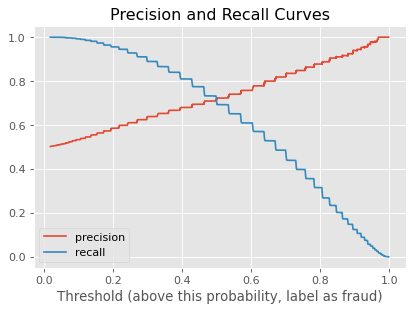

In [75]:

# We can also use the probabilities to make a curve showing us how recall 
# and thresholds trade off 

precision_curve, recall_curve, threshold_curve = precision_recall_curve(y_test, logit.predict_proba(X_test_sub1)[:,1] )

plt.figure(dpi=80)
plt.plot(threshold_curve, precision_curve[1:],label='precision')
plt.plot(threshold_curve, recall_curve[1:], label='recall')
plt.legend(loc='lower left')
plt.xlabel('Threshold (above this probability, label as fraud)');
plt.title('Precision and Recall Curves');

The intersection above is the threshold value of where precision and recall are balanced.

You chose this threshold per use case..  Think about if i want to weigh precision or recall more for my use case.

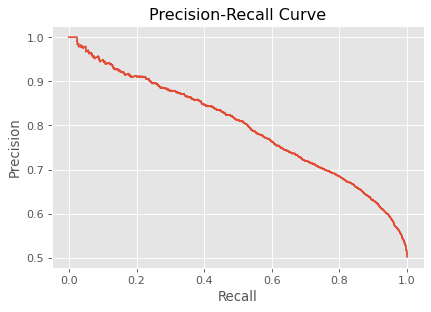

In [76]:
plt.figure(dpi=80)
plt.plot(recall_curve[1:], precision_curve[1:],label='precision')
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve");

In [78]:

# Precision = TP / (TP + FP)
# Recall = TP/P = True positive rate
# false positive rate = FP / true negatives = FP / (FP + TN) 
from sklearn.metrics import roc_auc_score, roc_curve

fpr, tpr, thresholds = roc_curve(y_test, logit.predict_proba(X_test_sub1)[:,1])

ROC AUC score =  0.798930581002961


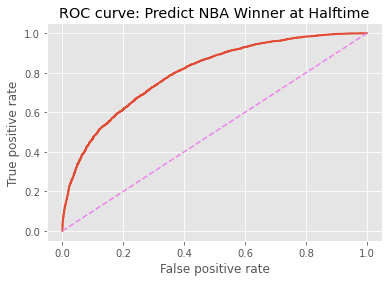

In [82]:

plt.plot(fpr, tpr,lw=2)
plt.plot([0,1],[0,1],c='violet',ls='--')
plt.xlim([-0.05,1.05])
plt.ylim([-0.05,1.05])


plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve: Predict NBA Winner at Halftime');
print("ROC AUC score = ", roc_auc_score(y_test, logit.predict_proba(X_test_sub1)[:,1]))

### Maybe consider doing log loss here